In [7]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.model_selection import train_test_split
from sklearn import metrics

pd.set_option('display.max_rows', None)

# Load Data

In [8]:
data_url = "https://s3-us-west-2.amazonaws.com/pcadsassessment/parking_citations.corrupted.csv"

In [9]:
df = pd.read_csv(data_url, low_memory=False)

In [ ]:
# df = df_raw.copy()

In [10]:
df.head()

,Ticket number,Issue Date,Issue time,Meter Id,Marked Time,RP State Plate,Plate Expiry Date,VIN,Make,Body Style,Color,Location,Route,Agency,Violation code,Violation Description,Fine amount,Latitude,Longitude
0,1103341116,2015-12-21T00:00:00,1251.0,NaN,NaN,CA,200304.0,NaN,NaN,PA,GY,13147 WELBY WAY,01521,1.0,4000A1,NO EVIDENCE OF REG,50.0,99999.0,99999.0
1,1103700150,2015-12-21T00:00:00,1435.0,NaN,NaN,CA,201512.0,NaN,NaN,VN,WH,525 S MAIN ST,1C51,1.0,4000A1,NO EVIDENCE OF REG,50.0,99999.0,99999.0
2,1104803000,2015-12-21T00:00:00,2055.0,NaN,NaN,CA,201503.0,NaN,NaN,PA,BK,200 WORLD WAY,2R2,2.0,8939,WHITE CURB,58.0,6439997.9,1802686.4
3,1104820732,2015-12-26T00:00:00,1515.0,NaN,NaN,CA,NaN,NaN,NaN,PA,WH,100 WORLD WAY,2F11,2.0,000,17104h,NaN,6440041.1,1802686.2
4,1105461453,2015-09-15T00:00:00,115.0,NaN,NaN,CA,200316.0,NaN,CHEV,PA,BK,GEORGIA ST/OLYMPIC,1FB70,1.0,8069A,NO STOPPING/STANDING,93.0,99999.0,99999.0


In [11]:
len(df.index)

8726014

In [12]:
df = df.rename(columns={
    'Make': 'make',
    'Ticket number': 'ticket_number',
    'Issue Date': 'issue_date',
    'Issue time': 'issue_time',
    'Meter Id': 'meter_id',
    'Marked Time': 'marked_time',
    'RP State Plate': 'rp_state_plate',
    'Plate Expiry Date': 'plate_expiry_date',
    'VIN': 'vin',
    'Make': 'make', 
    'Body Style': 'body_style',
    'Color': 'color',
    'Location': 'location',
    'Route': 'route',
    'Agency': 'agency',
    'Violation code': 'violation_code',
    'Violation Description': 'violation_description',
    'Fine amount': 'fine_amount',
    'Latitude': 'latitude',
    'Longitude': 'longitude'
})

In [13]:
df.dtypes

ticket_number             object
issue_date                object
issue_time               float64
meter_id                  object
marked_time              float64
rp_state_plate            object
plate_expiry_date        float64
vin                       object
make                      object
body_style                object
color                     object
location                  object
route                     object
agency                   float64
violation_code            object
violation_description     object
fine_amount              float64
latitude                 float64
longitude                float64
dtype: object

In [ ]:
# df_query = df[df['make'].isnull()]

In [ ]:
# df_query.head()

Given more time, I would analyze the two halves of the dataset to see if the distribution of the other fields is approximately the same in both halves or if there is some skew

In [14]:
df_data = df[~df['make'].isnull()]

In [15]:
len(df_data.index)

4357544

In [16]:
# Checking how many null values exist in each column (count)
df_data.isnull().sum()

ticket_number                  0
issue_date                     0
issue_time                   995
meter_id                 3223695
marked_time              4212622
rp_state_plate               391
plate_expiry_date         396547
vin                      4349402
make                           0
body_style                  3990
color                       1514
location                     149
route                      31677
agency                         6
violation_code                 0
violation_description        431
fine_amount                 3195
latitude                       1
longitude                      1
dtype: int64

In [17]:
# Checking how many null values exist in each column (percentage)
100*df_data.isnull().sum()/len(df_data.index)

ticket_number             0.000000
issue_date                0.000000
issue_time                0.022834
meter_id                 73.979632
marked_time              96.674228
rp_state_plate            0.008973
plate_expiry_date         9.100241
vin                      99.813152
make                      0.000000
body_style                0.091565
color                     0.034744
location                  0.003419
route                     0.726946
agency                    0.000138
violation_code            0.000000
violation_description     0.009891
fine_amount               0.073321
latitude                  0.000023
longitude                 0.000023
dtype: float64

In [19]:
# Drop vin, marked_time, and meter_id because there are too many null values
df_data = df_data.drop(columns=['meter_id', 'marked_time', 'vin'])

Given more time, I would analyze whether the null values for a certain field correspond with a specific output class/classes, particularly minority classes (removing the records with these nulls would skew the dataset). I would also see if I can impute values for these nulls by using the median or mode for continuous variables and maybe the most frequently occurring value for categorical variables. I would run experiments to test the model with and without these imputations to see which approach would be best 

In [23]:
# Drop records where any input variable field is null
df_data = df_data.dropna()

In [24]:
df_data.isnull().sum()

ticket_number            0
issue_date               0
issue_time               0
rp_state_plate           0
plate_expiry_date        0
make                     0
body_style               0
color                    0
location                 0
route                    0
agency                   0
violation_code           0
violation_description    0
fine_amount              0
latitude                 0
longitude                0
dtype: int64

In [96]:
df_data.head()

,issue_date,issue_time,rp_state_plate,plate_expiry_date,make,body_style,color,route,agency,violation_code,fine_amount,latitude,longitude
4,20150915.0,115.0,CA,200316.0,CHEV,PA,BK,1FB70,1.0,8069A,93.0,99999.0,99999.0
6,20151217.0,1710.0,CA,201605.0,MAZD,PA,BL,00217,1.0,8070,163.0,99999.0,99999.0
10,20151222.0,1100.0,CA,201511.0,FORD,TR,WH,2A75,1.0,8069AA,93.0,99999.0,99999.0
11,20151222.0,1105.0,CA,201701.0,CHRY,PA,GO,2A75,1.0,8069AA,93.0,99999.0,99999.0
19,20151222.0,1102.0,CA,201606.0,HOND,PA,BK,2A1,1.0,8069B,73.0,99999.0,99999.0


Given more time, I would perform additional cleaning such as standardization of continuous input variables.

## Exploring violation code and violation description fields

#### Summary of exploration
The fields "violation code" and "violation description" seem to provide the same information but there is no 1:1 mapping between the two like you would expect. 

There are only 13 codes that have multiple descriptions, and similar codes have similar descriptions, so we will use the code and drop the description column due to typos, etc. Also violation code has no null values whereas violation description does have null values.
Given more time, I could try to clean up the violation code and violation description fields to create a 1:1 mapping and see if it changes the performance of the model. 

In [161]:
df_data['violation_description'].nunique()

600

In [162]:
df_data['violation_code'].nunique()

282

In [163]:
# Each description has multiple codes under it
df_violation = df_data.groupby('violation_description')['violation_code'].apply(lambda x: x.nunique() == 1)\
.to_frame('single_violation_code')\
.reset_index()

In [164]:
df_violation[df_violation['single_violation_code'] == False]

,violation_description,single_violation_code
16,18 IN. CURB/2 WAY,False
126,22658A,False
289,8054,False
395,ADVERTISING ON VEH,False
397,AUDIBLE ALARM,False
404,BLOCKING DRIVEWAY,False
408,CATERING VIOLATION,False
411,CITY PARK/PROHIB,False
412,CLEANING VEH/STREET,False
414,COMM TRAILER/22 FT.,False


In [165]:
# Each code has multiple descriptions below it
df_code = df_data.groupby('violation_code')['violation_description'].apply(lambda x: x.nunique() == 1)\
.to_frame('single_violation_desc')\
.reset_index()

In [166]:
df_code[df_code['single_violation_desc'] == False]

,violation_code,single_violation_desc
0,000,False
38,21211B,False
66,22507.8C,False
68,22507.8C2,False
74,22507A,False
80,22511.57,False
93,22526,False
133,6344K2,False
134,6344K7,False
135,6344K8,False


In [167]:
df[df['violation_code'] == '80.69.2'].groupby('violation_description').count()

,ticket_number,issue_date,issue_time,meter_id,marked_time,rp_state_plate,plate_expiry_date,vin,make,body_style,color,location,route,agency,violation_code,fine_amount,latitude,longitude
violation_description,,,,,,,,,,,,,,,,,,
COMM VEH OVER TIME L,17860,17856,17854,0,1,17859,14038,85,8813,17856,17856,17856,17856,17856,17860,17522,17860,17860
COMM VEH OVER TIME LIMIT,20097,20096,20096,0,0,20097,15959,0,10000,20096,20096,20096,20095,20096,20097,19988,20097,20097


In [169]:
df_data['violation_code'].value_counts()

80.69BS      1220241
88.13B+       761734
80.56E4+      303235
80.58L        299488
5204A-        267438
80.69B        185573
80.69C        145099
5200          119369
80.56E1        94060
80.69AP+       78415
80.61          61250
22500E         54241
80.69A+        48427
80.70          46740
80.56E2        45450
8069BS         44610
80.69AA+       44402
4000A1         43006
22500F         39872
22502A         38239
80.73.2        37157
22514          34179
22500H         28877
88.03A         26896
88.63B+        22656
8056E4         19538
80.69.2        18813
5204A          12913
8069B           9333
8813B           8813
80.53           8229
22507.8A-       8151
8939            8055
8069A           7582
80.54H1         7185
8603            6695
80.49+          6389
8058L           6330
22507.8A        6183
80.66.1D        5636
80.71.4         5108
225078A         4927
5200A           4824
013             4387
80714           4060
22500I-         4018
22500B          3865
80.69.1A     

In [170]:
df_data['violation_description'].value_counts()

NO PARK/STREET CLEAN                   1264851
METER EXP.                              761734
RED ZONE                                322789
PREFERENTIAL PARKING                    299488
DISPLAY OF TABS                         267438
NO PARKING                              194911
DISPLAY OF PLATES                       119369
WHITE ZONE                               97006
NO STOP/STANDING                         78415
PARKED OVER TIME LIMIT                   76903
PARKED OVER TIME LIM                     68196
STANDNG IN ALLEY                         61250
BLOCKING DRIVEWAY                        54243
STOP/STAND PROHIBIT                      48427
YELLOW ZONE                              46362
NO STOP/STAND                            44402
NO EVIDENCE OF REG                       43006
PARKED ON SIDEWALK                       39873
18 IN. CURB/2 WAY                        38244
EXCEED 72HRS-ST                          37157
FIRE HYDRANT                             34179
DOUBLE PARKIN

## Cleaning up date and time fields

Given more time, I could convert issue_date, issue_time, and plate_expiry_date into datetime fields and then split out the year, month, date, hour, and minute into separate columns. For now, I am just removing extraneous characters in issue_date and converting to a numerical value since time can be considered a continuous variable.

In [27]:
df_data['issue_date'] = df_data['issue_date'].apply(lambda x: float(x.split('T')[0].replace('-', '')))

In [29]:
# drop ticket_number because it's unique for each record so doesn't provide any information
# drop location bc it's a text field and we can assume we have the same information stored in latitude and longitude
# (could analyze this further given more time)
# drop violation_description because we have almost the same data in violation_code

df_data = df_data.drop(columns=['ticket_number', 'location', 'violation_description'], errors='ignore')

In [30]:
df_data.head()

,issue_date,issue_time,rp_state_plate,plate_expiry_date,make,body_style,color,route,agency,violation_code,fine_amount,latitude,longitude
4,20150915.0,115.0,CA,200316.0,CHEV,PA,BK,1FB70,1.0,8069A,93.0,99999.0,99999.0
6,20151217.0,1710.0,CA,201605.0,MAZD,PA,BL,00217,1.0,8070,163.0,99999.0,99999.0
10,20151222.0,1100.0,CA,201511.0,FORD,TR,WH,2A75,1.0,8069AA,93.0,99999.0,99999.0
11,20151222.0,1105.0,CA,201701.0,CHRY,PA,GO,2A75,1.0,8069AA,93.0,99999.0,99999.0
19,20151222.0,1102.0,CA,201606.0,HOND,PA,BK,2A1,1.0,8069B,73.0,99999.0,99999.0


In [31]:
df_data.dtypes

issue_date           float64
issue_time           float64
rp_state_plate        object
plate_expiry_date    float64
make                  object
body_style            object
color                 object
route                 object
agency               float64
violation_code        object
fine_amount          float64
latitude             float64
longitude            float64
dtype: object

Given more time, I would one hot encode the remaining categorical variables (we could also use embeddings to encode them). My kernel kept crashing when trying to do this so for now I have just deleted all categorical variables

In [ ]:
# One hot encode the remaining categorical variables (we would ideally use an embedding)
# plate_encoded = pd.get_dummies(df_data['rp_state_plate'], drop_first=True)
# body_style_encoded = pd.get_dummies(df_data['body_style'], drop_first=True)
# color_encoded = pd.get_dummies(df_data['color'], drop_first=True)
# route_encoded = pd.get_dummies(df_data['route'], drop_first=True)
# violation_code_encoded = pd.get_dummies(df_data['violation_code'], drop_first=True)

In [ ]:
# len(violation_code_encoded.columns)

In [ ]:
# final_df = pd.concat([df_data, plate_encoded, body_style_encoded, color_encoded, violation_code_encoded], axis=1)
# final_df.head()

In [ ]:
# final_df = final_df.drop(['rp_state_plate', 'body_style', 'color', 'violation_code', 'route'], axis=1, errors='ignore')

In [ ]:
# len(final_df.columns)

In [ ]:
# final_df.head()

In [ ]:
# final_df.dtypes

Checking the collinearity of the data.

Latitude and longitude are highly correlated, and upon further investigation, we see that a large number of records have latitude = 99999.0 and longitude 99999.0 while the rest of the numbers are 7 digit numbers. Given more time, I would clean this up

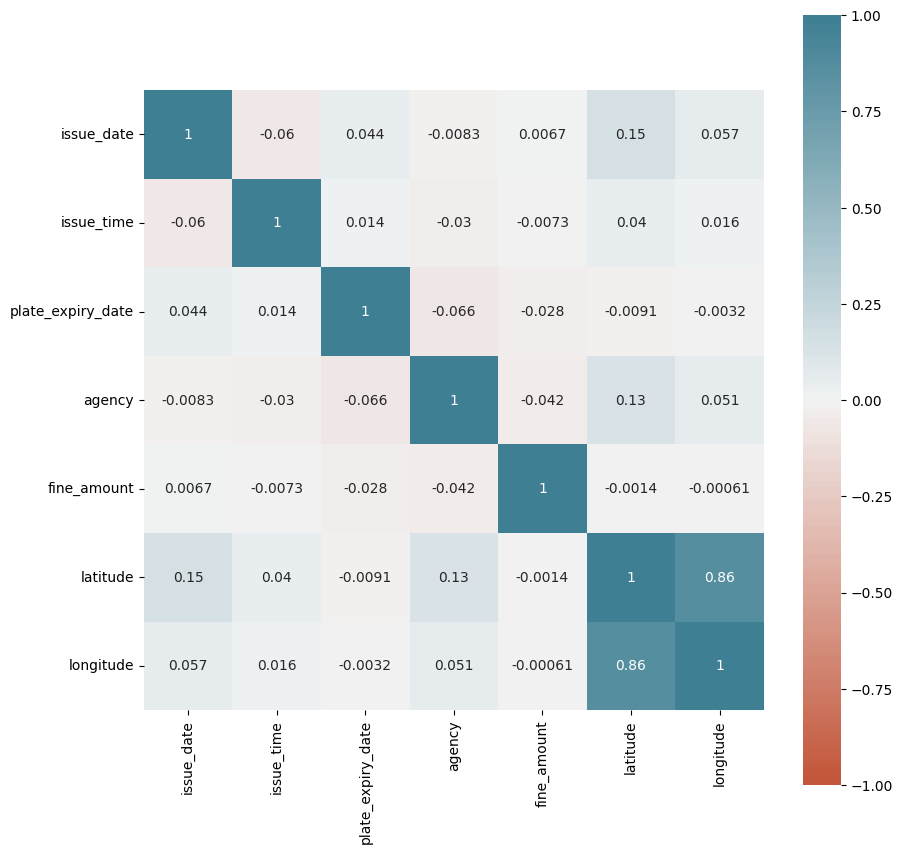

In [33]:
plt.figure(figsize=(10, 10))
ax = sns.heatmap(df_data.corr(), 
                 vmin=-1, vmax=1, center=0,
                 cmap=sns.diverging_palette(20, 220, n=200),
                 square=True,
                 annot=True
                )

In [181]:
df_data['latitude'].value_counts()

9.999900e+04    653590
6.463690e+06      4188
6.419829e+06      3757
6.458312e+06      3407
6.462121e+06      3399
6.463690e+06      3222
6.461454e+06      2861
6.448999e+06      2651
6.421106e+06      2608
6.458312e+06      2363
6.463690e+06      2205
6.463690e+06      2117
6.449301e+06      1891
6.457731e+06      1838
6.457731e+06      1833
6.470141e+06      1794
6.486945e+06      1774
6.449000e+06      1714
6.426798e+06      1705
6.431428e+06      1684
6.421786e+06      1639
6.447001e+06      1599
6.439920e+06      1588
6.462121e+06      1564
6.483074e+06      1553
6.419538e+06      1532
6.447001e+06      1519
6.427693e+06      1506
6.427279e+06      1492
6.497080e+06      1489
6.461452e+06      1485
6.426798e+06      1480
6.448999e+06      1468
6.482865e+06      1466
6.427372e+06      1452
6.447001e+06      1441
6.462121e+06      1441
6.457482e+06      1440
6.485641e+06      1439
6.418424e+06      1420
6.444605e+06      1409
6.461016e+06      1407
6.459911e+06      1403
6.486375e+0

In [182]:
df_data['longitude'].value_counts()

9.999900e+04    653590
1.819688e+06      3757
1.859071e+06      3407
1.849114e+06      3222
1.882602e+06      2651
1.819197e+06      2608
1.849114e+06      2534
1.859071e+06      2392
1.848423e+06      2117
1.858944e+06      1949
1.836817e+06      1915
1.882982e+06      1891
1.864752e+06      1883
1.859358e+06      1833
1.867430e+06      1794
1.841541e+06      1774
1.883364e+06      1714
1.845451e+06      1711
1.837270e+06      1684
1.845113e+06      1641
1.840434e+06      1639
1.845451e+06      1639
1.858229e+06      1604
1.876409e+06      1599
1.852081e+06      1590
1.802687e+06      1588
1.857542e+06      1564
1.857542e+06      1556
1.842165e+06      1553
1.862387e+06      1538
1.846455e+06      1532
1.848423e+06      1522
1.836367e+06      1506
1.889149e+06      1492
1.872235e+06      1489
1.858854e+06      1485
1.882602e+06      1468
1.850212e+06      1466
1.858205e+06      1441
1.876390e+06      1441
1.849337e+06      1440
1.839201e+06      1439
1.841659e+06      1420
1.803444e+0

In [ ]:
df_data[df_data['latitude'] == 99999.0]

# Build Models

Since we want the probability that a given record will have a particular make, this is a multi-class classification problem. Given the large number of records (~4 million) in the training dataset, a neural network seems like it could be a good option.

In [34]:
import tensorflow
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense

import numpy as np

from scipy.stats import uniform, randint

from sklearn.datasets import load_breast_cancer, load_diabetes, load_wine
from sklearn.metrics import auc, accuracy_score, confusion_matrix, mean_squared_error
from sklearn.model_selection import cross_val_score, GridSearchCV, KFold, RandomizedSearchCV, train_test_split

In [35]:
# Would normally do one hot encoding, but in order to get a working model, for the time being, we will drop the 
# categorical variables and only work with the continuous variables

df_y = df_data[['make']]
df_x = df_data.drop(['rp_state_plate', 'make', 'body_style', 'color', 'route', 'violation_code'], axis=1, errors='ignore')

In [74]:
X_train, X_test, y_train, y_test = train_test_split(df_x, df_y, test_size=0.25, random_state=0)

In [56]:
df_x.shape

(3924726, 7)

In [57]:
df_y.shape

(3924726, 1)

In [43]:
X_train.shape

(2943544, 7)

In [75]:
y_train.shape

(2943544, 1)

In [78]:
y_train_one_hot = pd.get_dummies(y_train, drop_first=True).values

In [79]:
y_train_one_hot.shape

(2943544, 966)

In [86]:
y_train_one_hot

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], dtype=uint8)

In [95]:
X_train.columns

Index(['issue_date', 'issue_time', 'plate_expiry_date', 'agency',
       'fine_amount', 'latitude', 'longitude'],
      dtype='object')

In [1]:
input_layer_size = len(df_x.columns)
input_layer_size

NameError: name 'df_x' is not defined

In [87]:
# Neural Network Model
model = Sequential()
model.add(Dense(64, input_shape=(input_layer_size,), activation='relu'))
model.add(Dense(64, activation='relu'))
model.add(Dense(1, activation='softmax'))

In [91]:
model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])

I would run experiments using different network architectures to find the best one and test each architecture using something like 5-fold cross validation. I would evaluate the performance of each model based on various metrics like accuracy and also look at the confusion matrix and feature importances to iterate on the model. Once I have the best model, I would train it on all of the data to get the final trained model and save it.

In [ ]:
model.fit(X_train.to_numpy(), y_train_one_hot.to_numpy())